In [2]:
import pandas as pd

In [3]:
import plotly.express as px

In [4]:
import matplotlib.pyplot as plt
import seaborn as sns

In [5]:
airlines = pd.read_csv("./Data/Airlines.csv")

airports_coordinates = pd.read_csv("./Data/Airport Coordinates.csv")

In [88]:
# fig = px.scatter(penguins_dataframe, x="Body Mass (g)", y="Flipper Length (mm)")

# fig.show()

airlines

airports_coordinates

# merged = airlines.merge(right = airports_coordinates, how = 'left', left_on = 'AirportFrom', right_on = 'IATA')
# merged

,IATA,AIRPORT,LATITUDE,LONGITUDE,DELAY,SIZE
0,ABE,Lehigh Valley International,40.652363,-75.440402,32.16374,13399
1,ABI,Abilene Regional,32.411320,-99.681897,15.16588,18078
2,ABQ,Albuquerque International,35.040222,-106.609194,49.12469,29793
3,ABY,Southwest Georgia Regional,31.535515,-84.194473,25.28736,11820
4,ACT,Waco Regional,31.611288,-97.230519,28.33333,12210
...,...,...,...,...,...,...
287,VPS,Eglin Air Force Base,30.483250,-86.525400,33.17536,21988
288,WRG,Wrangell,56.484326,-132.369824,30.50847,5999
289,XNA,Northwest Arkansas Regional,36.281869,-94.306811,28.10284,17600
290,YAK,Yakutat,59.503361,-139.660226,15.78947,14220


In [34]:
columns_to_drop = ['id']

#Drop the columns using drop()
airlines.drop(columns_to_drop, axis=1, inplace = True)

In [35]:
# airlines["AirportFrom"].drop_duplicates()

# airlines[["AirportFrom","Delay"]].head(293)

# airlines.plot.scatter(x='AirportFrom',y='Delay')

fig = px.scatter(airlines, x="AirportFrom", y="Delay")

fig.show()

In [36]:
import pandas as pd
import plotly.express as px
data = pd.read_csv("./Data/Airlines.csv")
data.drop('id', axis=1, inplace=True)
df = data[['AirportFrom','Delay']].groupby('AirportFrom').agg('count').reset_index()
df.head(293)

,AirportFrom,Delay
0,ABE,342
1,ABI,211
2,ABQ,2799
3,ABR,2
4,ABY,87
...,...,...
288,VPS,633
289,WRG,59
290,XNA,1128
291,YAK,57


In [37]:
airlines

,Airline,Flight,AirportFrom,AirportTo,DayOfWeek,Time,Length,Delay
0,CO,269,SFO,IAH,3,15,205,1
1,US,1558,PHX,CLT,3,15,222,1
2,AA,2400,LAX,DFW,3,20,165,1
3,AA,2466,SFO,DFW,3,20,195,1
4,AS,108,ANC,SEA,3,30,202,0
...,...,...,...,...,...,...,...,...
539378,CO,178,OGG,SNA,5,1439,326,0
539379,FL,398,SEA,ATL,5,1439,305,0
539380,FL,609,SFO,MKE,5,1439,255,0
539381,UA,78,HNL,SFO,5,1439,313,1


In [23]:
airlines_df = airlines[['Airline','Flight','AirportFrom','AirportTo','DayOfWeek','Time','Length','Delay']]
fig = px.scatter_matrix(airlines,dimensions=['Airline','Flight','AirportFrom','AirportTo','DayOfWeek','Time','Length','Delay'],color="Delay")
# fig = px.scatter_matrix(airlines,dimensions=['AirportFrom','Delay'],color="Airline")
# fig = px.scatter_matrix(airlines_df)
fig.update_traces(diagonal_visible=False)
fig.show()

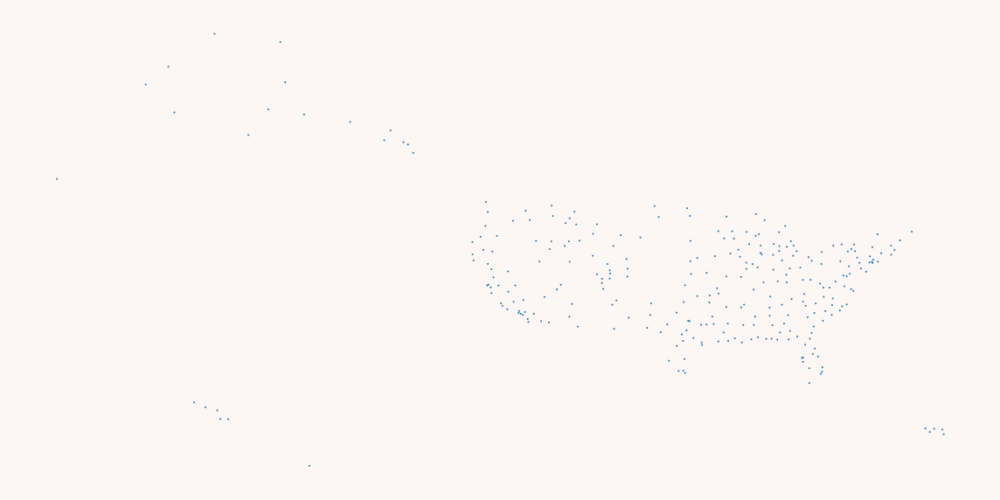

In [39]:
import matplotlib.pyplot as plt

airports_coordinates = pd.read_csv("./Data/Airport Coordinates.csv")
fig, ax = plt.subplots(facecolor='#FCF6F5FF')
fig.set_size_inches(10, 5)

ax.scatter(airports_coordinates['LONGITUDE'], airports_coordinates['LATITUDE'], s=1, alpha=1, edgecolors='none')
ax.axis('off')

plt.show()

In [40]:
# df = px.data.gapminder().query("year==2007")
airports_coordinates = pd.read_csv("./Data/Airport Coordinates.csv")
# merged = airlines.merge(right = airports_coordinates, how = 'left', left_on = 'AirportFrom', right_on = 'IATA')
# fig = px.scatter_geo(airports_coordinates, locations="iso_alpha",hover_name="AIRPORT", size="DELAY",projection="natural earth")

import plotly.graph_objects as go

import pandas as pd

df = pd.read_csv("./Data/Airport Coordinates.csv")
df['text'] = df['IATA'] + ',' + df['AIRPORT'] + ',' + df['DELAY'].astype(str)
# IATA,AIRPORT,LATITUDE,LONGITUDE,DELAY ',' + df['LATITUTE'] + ',' + df['LONGITUDE'] +

fig = go.Figure(data=go.Scattergeo(
        lon = df['LONGITUDE'],
        lat = df['LATITUDE'],
        text = df['text'],
        mode = 'markers',
        marker_color = df['DELAY'],
        ))

fig.update_layout(
        title = 'Highest Delayed Airports (United States)',
        geo_scope='north america',
    )
fig.show()

In [78]:
airports_coordinates = pd.read_csv("./Data/Airport Coordinates.csv")

import plotly.graph_objects as go

import pandas as pd

df = pd.read_csv("./Data/Airport Coordinates.csv")
# df['text'] = df['IATA'] + ',' + df['AIRPORT'] + ',' + df['DELAY'].astype(str)
df['text'] = df['IATA'] + ', ' + df['AIRPORT'] + '</br>' + df['DELAY'].astype(str) + '% delay'

fig = go.Figure(data=go.Scattergeo(
        lon = df['LONGITUDE'],
        lat = df['LATITUDE'],
        text = df['text'],
        mode = 'markers',
        marker = dict(
            size = 8,
            opacity = 0.8,
            reversescale = True,
            autocolorscale = False,
            symbol = 'circle',
            line = dict(
                width=0.3,
                color='rgba(102, 102, 102)'
            ),
#             colorscale = [[0, 'red'], [0.25, 'orange'], [0.5, 'green'], [0.75, 'blue'], [1, 'purple']],
            colorscale = [[0, 'red'], [0.3, 'orange'], [0.5, 'yellow'], [1, 'green']],
            cmin = 0,
            color = df['DELAY'],
            cmax = df['DELAY'].max(),
            colorbar_title="Likelihood of Delays<br>(In percentages)"
        )))

fig.update_layout(
        title = 'Most delayed United States airports!<br>(Hover for airport names)',
        geo = dict(
            scope='north america',
            projection_type='albers',
            showland = True,
            landcolor = "lightblue",
            subunitcolor = "rgb(217, 217, 217)",
            countrycolor = "rgb(217, 217, 217)",
            countrywidth = 0.25,
            subunitwidth = 0.5
        ),
    )
fig.show()

In [75]:
airports_coordinates = pd.read_csv("./Data/Airport Coordinates.csv")

import plotly.graph_objects as go

import pandas as pd

df = pd.read_csv("./Data/Airport Coordinates.csv")
df['text'] = df['IATA'] + ', ' + df['AIRPORT'] + '</br>' +  (df["SIZE"]*1000).astype(str) + ' sq. ft. (sum of runway length) </br>' + df['DELAY'].astype(str) + '% delay'

fig = go.Figure(data=go.Scattergeo(
        lon = df['LONGITUDE'],
        lat = df['LATITUDE'],
        text = df['text'],
        mode = 'markers',
        marker = dict(
            size = df['SIZE']/2,
            opacity = 0.8,
            reversescale = True,
            autocolorscale = False,
            symbol = 'circle',
            line = dict(
                width=0.3,
                color='rgba(102, 102, 102)'
            ),
#             colorscale = [[0, 'red'], [0.25, 'orange'], [0.5, 'green'], [0.75, 'blue'], [1, 'purple']],
            colorscale = [[0, 'red'], [0.3, 'orange'], [0.5, 'yellow'], [1, 'green']],
            cmin = 0,
            color = df['DELAY'],
            cmax = df['DELAY'].max(),
            colorbar_title="Likelihood of Delays<br>(In percentages)"
        )))

fig.update_layout(
        title = 'Most delayed United States airports!<br>(Hover for airport names)',
        geo = dict(
            scope='north america',
            projection_type='albers',
            showland = True,
            landcolor = "lightblue",
            subunitcolor = "rgb(217, 217, 217)",
            countrycolor = "rgb(217, 217, 217)",
            countrywidth = 0.25,
            subunitwidth = 0.5
        ),
    )
fig.show()

In [73]:
import plotly.graph_objects as go
import numpy as np
import pandas as pd

df = pd.read_csv("./Data/Airport Coordinates.csv")

# Create figure
fig = go.Figure()

# Add traces, one for each slider step
for step in np.arange(0, 5, 1):
    fig.add_trace(
        go.Scatter(
            visible=False,
            line=dict(color="#00CED1", width=6),
            name="𝜈 = " + str(step),
            x=np.arange(0, 10, 0.01),
            y=np.sin(step * np.arange(0, 10, 0.01))))

# Make 10th trace visible
fig.data[10].visible = True

# Create and add slider
steps = []
for i in range(len(fig.data)):
    step = dict(
        method="update",
        args=[{"visible": [False] * len(fig.data)},
              {"title": "Slider switched to step: " + str(i)}],  # layout attribute
    )
    step["args"][0]["visible"][i] = True  # Toggle i'th trace to "visible"
    steps.append(step)

sliders = [dict(
    active=10,
    currentvalue={"prefix": "Frequency: "},
    pad={"t": 50},
    steps=steps
)]

fig.update_layout(
    sliders=sliders
)

fig.show()

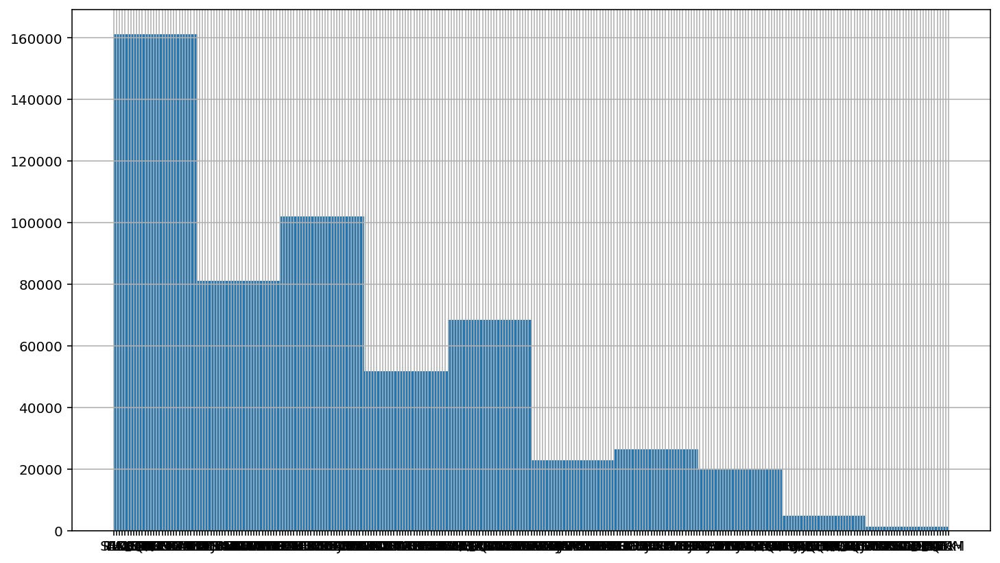

In [9]:
airlines.AirportFrom.hist()

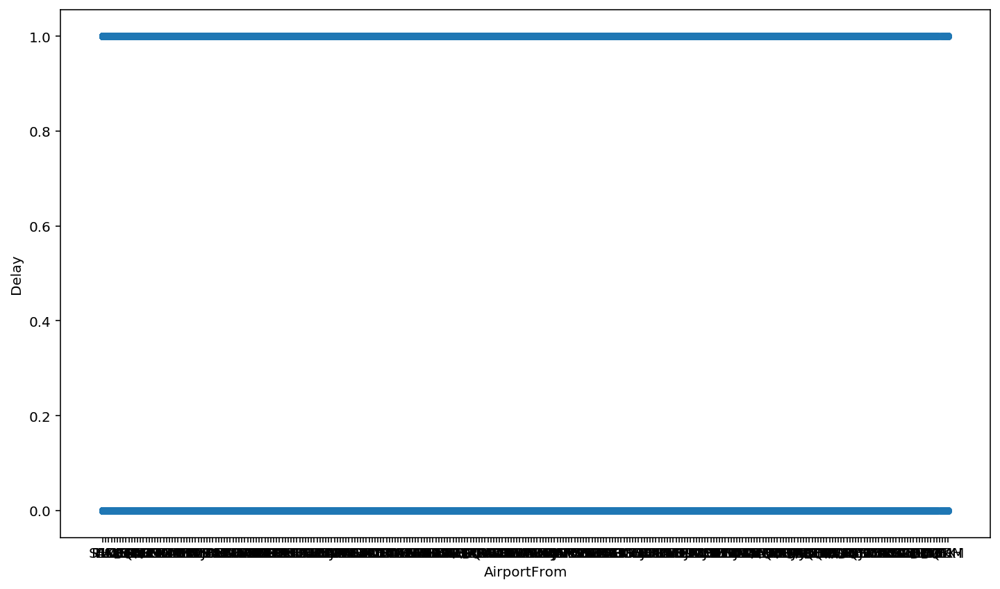

In [9]:
airlines.plot.scatter(x='AirportFrom',y='Delay')